# Import Libraries

In [1]:
!pip install faiss-cpu -q
!pip install git+https://github.com/cvg/LightGlue.git -q
!pip install pycolmap -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.3/31.3 MB 60.4 MB/s eta 0:00:00:00:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 25.5 MB/s eta 0:00:0000:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 11.6 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 63.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 97.4 MB/s eta 0:00:00:00:01:01


In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from collections import defaultdict
from tqdm import tqdm
from itertools import combinations
import h5py
import dataclasses

import cv2
from PIL import Image

import torch
from transformers import AutoImageProcessor, AutoModel
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms
from typing import Optional, Tuple
import torch.nn.functional as F

import faiss
import networkx as nx
from community import community_louvain

from lightglue import LightGlue, SuperPoint, ALIKED
from lightglue.utils import rbd
from lightglue import viz2d
import pycolmap
from torchvision import transforms as T

import sys, warnings
sys.path.append("/kaggle/input/imc25-utils")

from database import *
from h5_to_db import *
import metric
import shutil

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
from typing import Callable, List, Optional, Tuple, Union
from pathlib import Path

# import open3d as o3d
# from open3d import JVisualizer
from mpl_toolkits.mplot3d import Axes3D


2025-06-23 07:19:14.941060: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750663155.110179      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750663155.158535      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/usr/local/lib/python3.11/dist-packages/lightglue/lightglue.py:24: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


# Proposed Pipeline

### Step 1: Global Clustering with DINO + FAISS + Louvain

* Used DINOv2 Vision Transformers to extract global descriptors.
* Construct a similarity graph via FAISS (cosine similarity).
* Apply Louvain community detection to segment images into scene-level clusters.


### Step 2: Local Matching with SuperPoint + LightGlue

* Within each cluster, extract keypoints using SuperPoint.
* Match image pairs using LightGlue with geometric filtering.
* Store keypoints and inliers in HDF5 format for downstream Structure from Motion(SfM).


### Step 3: 3D Reconstruction with COLMAP + PyCOLMAP
* For each cluster, import images and feature matches into COLMAP.
* Run incremental SfM to recover camera poses and sparse 3D points.
* Run incremental SfM to reconstruct poses and sparse 3D points.
* Reproject 3D points to generate sparse depth maps per image.
* Store metadata in a Predictions dataclass: pose, intrinsics, depth maps, and 2D projections.


### Step 4: Visualization 
* Visualize SuperPoint keypoints and LightGlue matches per image pair.
* Overlay sparse depth maps on input images to highlight scene geometry.
* Plot epipolar lines using predicted camera intrinsics and relative pose (from Step 3).  

# STEP 1

In [3]:
# to extract  global feature using DINO Vision Transformers (ViTs)
all_features = []
image_paths = []

def global_feature_extractor(
    device, 
    Dataloader,
    verbose = True,
    pooling = 'mac',
    model_path = '/kaggle/input/dinov2/pytorch/giant/1'):
    
    assert pooling in ["mac", "cls"], "Pooling must be 'mac' or 'cls'"
    loop = tqdm(Dataloader, desc="Extracting DINO features", disable=not verbose)
    
    processor = AutoImageProcessor.from_pretrained(model_path,use_fast=True)
    dino_model = AutoModel.from_pretrained(model_path)
    dino_model = dino_model.eval().to(device)
    
    with torch.inference_mode():
        feature_list = []
        for images, metadata in loop:
            inputs = processor(images=images, return_tensors="pt",do_rescale=False).to(device)
            outputs = dino_model(**inputs)
            if pooling == 'mac':
                # last_hidden_state shape: (batch_size, sequence_length, hidden_dim)
                vec = F.normalize(outputs.last_hidden_state[:,1:].max(dim=1)[0], dim=1, p=2) #all
            else:
                vec = F.normalize(outputs.last_hidden_state[:,0], dim=1, p=2) # batch, hidden_dim
            feature_list.append(vec.detach().cpu())
            image_paths.extend(metadata['image_path'])
            
        all_feature_list = torch.cat(feature_list, dim=0)
        
    return all_feature_list.numpy(), image_paths

In [4]:
# to build FAISS knn graph from global features
def build_knn_graph(features, data_dir, img_paths, k=10):
    """
    Build a kNN graph using cosine similarity and per-scene threshold filtering.
    
    features: np.ndarray of global descriptors
    img_paths: List of paths aligned with features
    scene_thresholds: Dict[scene_name] -> float [mid-value]
    k: number of neighbors

    Returns:
        List of (i, j, sim) edges that pass scene threshold check
    """
    def load_threshold():
        """
        return mid threshold value per scene in a Dict
        """
        threshold = os.path.join(data_dir, "train_thresholds.csv")
        thresh_df = pd.read_csv(threshold)
        tdict = dict()
        for _, row in thresh_df.iterrows():
            tdict[row["scene"]] = float(row['thresholds'].split(';')[-1])
            
        return tdict
    
    
    features = features.astype(np.float32)
    features /= np.linalg.norm(features, axis=1, keepdims=True)

    index = faiss.IndexFlatIP(features.shape[1])  # inner product = cosine sim if normalized
    index.add(features)
    distances, indices = index.search(features, k + 1)  # +1 because self-match at index 0

    paths = [os.path.dirname(p).split("/")[-1] for p in img_paths]
    og_scene_threshold = load_threshold()


    edges = []
    num_points = features.shape[0]
    for i in range(num_points):
        for j in range(1, k + 1):  # skip self-match
            neighbor = indices[i][j]
            sim = distances[i][j]

            scene_1 = paths[i]
            scene_2 = paths[neighbor]

            if scene_1 == scene_2:
                threshold = og_scene_threshold.get(scene_1, 0.1)
                if sim >= threshold:
                    edges.append((i, neighbor, sim))
                else:
                    continue

    return edges

In [5]:
def build_graph_from_edges(edges):
    """
    Builds a weighted undirected NetworkX graph from edge list (i, j, weight)
    """
    G = nx.Graph()
    for i, j, sim in edges:
        G.add_edge(i, j, weight=sim)
    return G

def louvian_cluster(graph):
    return community_louvain.best_partition(graph,weight = 'weight')

# STEP 2

In [6]:
# superpoint + lightglue -> match_pair [reformat]

In [7]:
# img_load -> from lightglue util.py

def read_image(path, grayscale: bool = False) -> np.ndarray:
    """Read an image from path as RGB or grayscale"""
    if not Path(path).exists():
        raise FileNotFoundError(f"No image at path {path}.")
    mode = cv2.IMREAD_GRAYSCALE if grayscale else cv2.IMREAD_COLOR
    image = cv2.imread(str(path), mode)
    if image is None:
        raise IOError(f"Could not read image at {path}.")
    if not grayscale:
        image = image[..., ::-1]
    return image

def resize_image(
    image: np.ndarray,
    size: Union[List[int], int],
    fn: str = "max",
    interp: Optional[str] = "area",
) -> np.ndarray:
    """Resize an image to a fixed size, or according to max or min edge."""
    h, w = image.shape[:2]

    fn = {"max": max, "min": min}[fn]
    if isinstance(size, int):
        scale = size / fn(h, w)
        h_new, w_new = int(round(h * scale)), int(round(w * scale))
        scale = (w_new / w, h_new / h)
    elif isinstance(size, (tuple, list)):
        h_new, w_new = size
        scale = (w_new / w, h_new / h)
    else:
        raise ValueError(f"Incorrect new size: {size}")
    mode = {
        "linear": cv2.INTER_LINEAR,
        "cubic": cv2.INTER_CUBIC,
        "nearest": cv2.INTER_NEAREST,
        "area": cv2.INTER_AREA,
    }[interp]
    return cv2.resize(image, (w_new, h_new), interpolation=mode), scale


def numpy_image_to_torch(image: np.ndarray) -> torch.Tensor:
    """Normalize the image tensor and reorder the dimensions."""
    if image.ndim == 3:
        image = image.transpose((2, 0, 1))  # HxWxC to CxHxW
    elif image.ndim == 2:
        image = image[None]  # add channel axis
    else:
        raise ValueError(f"Not an image: {image.shape}")
    return torch.tensor(image / 255.0, dtype=torch.float)

def load_image(path , resize: int = None, **kwargs) -> torch.Tensor:
    image = read_image(path)
    if resize is not None:
        image, _ = resize_image(image, resize, **kwargs)
    return numpy_image_to_torch(image)

In [8]:
def match_pair_lightglue_superpoint(
    image_fnames,
    image_pairs,
    device,
    min_matches=20
):
    os.makedirs(feature_dir, exist_ok=True)
    
    with h5py.File(f'{feature_dir}/keypoints.h5', 'a') as f_kp, \
        h5py.File(f'{feature_dir}/descriptors.h5', 'a') as f_desc, \
        h5py.File(f'{feature_dir}/matches.h5', 'a') as f_match:
        
        extractor = SuperPoint(max_num_keypoints=4096).eval().to(device)
        matcher = LightGlue(features='superpoint').eval().to(device)

        for path1, path2 in tqdm(image_pairs, desc="Extracting & Matching"):
            key1 = os.path.basename(path1)
            key2 = os.path.basename(path2)

              
            keyA, keyB = sorted([key1, key2])
            pathA, pathB = (path1, path2) if key1 == keyA else (path2, path1)

            if keyA in f_match and keyB in f_match[keyA]:
                continue

            try:
                imgA = load_image(pathA)
                imgB = load_image(pathB)

                featsA = extractor.extract(imgA.to(device))
                featsB = extractor.extract(imgB.to(device))

                matchesAB = matcher({"image0": featsA, "image1": featsB})
                featsA, featsB, matchesAB = [
                    rbd(x) for x in [featsA, featsB, matchesAB]]# remove batch_dimension

                matches = matchesAB["matches"]

                if matches.shape[0] < min_matches:
                    continue

                f_match.require_group(keyA).create_dataset(keyB, data=matches.cpu().numpy().astype(np.int32))

                if keyA not in f_kp:
                    f_kp.create_dataset(keyA, data=featsA["keypoints"].cpu().numpy())
                    f_desc.create_dataset(keyA, data=featsA["descriptors"].cpu().numpy())

                if keyB not in f_kp:
                    f_kp.create_dataset(keyB, data=featsB["keypoints"].cpu().numpy())
                    f_desc.create_dataset(keyB, data=featsB["descriptors"].cpu().numpy())

            except Exception as e:
                print(f"[ERROR] Matching failed for {key1} ↔ {key2}: {e}")
                continue


# STEP 3

In [9]:
# COLMAP & pycolmap

In [10]:
def run_colmap_reconstruction(
    cluster_imgs,
    feature_dir,
    cluster_idx,
    output_root
):
    """
    Performs COLMAP-based SfM for a given cluster.
    Steps:
      - Creates a working directory
      - Imports images, keypoints, matches into COLMAP
      - Runs incremental mapping
      - Returns pycolmap Reconstruction class objects 
    """

    os.makedirs(output_root, exist_ok=True)

    db_path = os.path.join(output_root, "colmap.db")
    if os.path.exists(db_path):
        os.remove(db_path)

    base_cluster_idic = {os.path.basename(p): p for p in cluster_imgs}
    

    def add_keypoints_flat(db, feature_dir, img_root, img_ext, camera_model, single_camera):
        f_kp = h5py.File(os.path.join(feature_dir, "keypoints.h5"), "r")
        fname_to_id = {}
        camera_id = None
        
        for img_name in tqdm(list(f_kp.keys()), desc="Add_Keypoints"):
            if img_name in base_cluster_idic.keys():
                full_img_path = base_cluster_idic.get(img_name)
                scene_img_path = os.path.relpath(full_img_path, img_root)
                
                if not os.path.isfile(full_img_path):
                    continue
            
                keypoints = f_kp[img_name][()]
                
                if len(keypoints) == 0:
                    print(f"for image {img_name} 0 keypoints")
                    continue
                
                if camera_id is None or not single_camera:
                    camera_id = create_camera(db, full_img_path, camera_model)
                    
                image_id = db.add_image(scene_img_path, camera_id)
                db.add_keypoints(image_id, keypoints)
                fname_to_id[img_name] = image_id
    
        return fname_to_id


    def add_matches_flat(db, feature_dir, fname_to_id):

        f_match = h5py.File(os.path.join(feature_dir, "matches.h5"), "r")
        added = set()
        n_total  = 0
        valid_pairs = 0
    
        # Estimate total number of match entries for tqdm
        n_keys = len(f_match.keys())
        n_total = (n_keys * (n_keys - 1)) // 2


        with tqdm(total=n_total, desc="Importing Matches") as pbar:         
            for key1 in f_match.keys():
                key_group = f_match[key1] 
                for key2 in key_group.keys():
                    
                    if key1 not in fname_to_id and key2 not in fname_to_id:
                        continue

                    id_1 = fname_to_id[key1]
                    id_2 = fname_to_id[key2]
                    pair_id = image_ids_to_pair_id(id_1, id_2)
                    if pair_id in added:
                        warnings.warn(f'Pair {pair_id} ({id_1}, {id_2}) already added!')
                        pbar.update(1)
                        continue
                        
                    matches = key_group[key2][()] 
                                        
                    matches = np.unique(matches.astype(np.uint32), axis=0)
                    if matches.shape[0] == 0 or matches.ndim != 2 or matches.shape[1]!=2:
                        pbar.update(1)
                        continue
                    db.add_matches(id_1, id_2, matches.astype(np.uint32))
                    db.add_two_view_geometry(id_1, id_2, matches)
                    added.add(pair_id)
                    pbar.update(1)
                    valid_pairs += 1
        
        print(f"[DEBUG] Total valid pairs added to DB: {valid_pairs}")
                        

    
    def import_into_colmap(img_list, feature_dir, database_path):
        
        db = COLMAPDatabase.connect(database_path)
        db.create_tables()
        
        fname_to_id = add_keypoints_flat(
            db,
            feature_dir,
            img_root="/kaggle/input/image-matching-challenge-2025/train",
            img_ext=".png", camera_model='pinhole', single_camera=False)
    
        add_matches_flat(
            db,
            feature_dir,
            fname_to_id
        )
    
        db.commit()
        return
    
    import_into_colmap(cluster_imgs, feature_dir, db_path)
    image_dir = "/kaggle/input/image-matching-challenge-2025/train"

    # RANSAC - pycolmap ver
    # pycolmap.match_exhaustive(db_path)
        
    
    maps = dict()
    mapper_options = pycolmap.IncrementalPipelineOptions()
    mapper_options.num_threads = 2
    
    scene_size = len(cluster_imgs)
    if scene_size <= 25:
        mapper_options.min_model_size = 3
        mapper_options.ba_refine_focal_length = True
        mapper_options.ba_refine_principal_point = False
        mapper_options.ba_refine_extra_params = False
        mapper_options.ba_local_num_images = 4
        mapper_options.ba_local_max_num_iterations = 15
        
    else:
        mapper_options.min_model_size = 8
        mapper_options.max_num_models = 25
        mapper_options.ba_refine_focal_length = True
        mapper_options.ba_refine_principal_point = True
        mapper_options.ba_refine_extra_params = True
        mapper_options.ba_local_num_images = 8
        mapper_options.ba_global_max_num_iterations = 80
        mapper_options.ba_local_max_num_iterations = 25
        mapper_options.ba_global_function_tolerance = 1e-5
        mapper_options.ba_local_function_tolerance = 1e-5

    
    maps = pycolmap.incremental_mapping(
        database_path=db_path,
        image_path=image_dir,
        output_path=output_root,
        options=mapper_options
    )


    return maps

# STEP 4

## keypoints and matches visualisation


In [11]:
def keypoint_match_visualiser(pose_img1, pose_img2):
             
    image0 = load_image(os.path.join(image_dir, "train", pose_img1))
    image1 = load_image(os.path.join(image_dir, "train", pose_img2))

    extractor = SuperPoint(max_num_keypoints=4096).eval().to(device)
    matcher = LightGlue(features='superpoint').eval().to(device)
    
    feats0 = extractor.extract(image0.to(device))
    feats1 = extractor.extract(image1.to(device))
    matches01 = matcher({"image0": feats0, "image1": feats1})
    feats0, feats1, matches01 = [
        rbd(x) for x in [feats0, feats1, matches01]
    ]  
    
    kpts0, kpts1, matches = feats0["keypoints"], feats1["keypoints"], matches01["matches"]
    m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]
    
    axes = viz2d.plot_images([image0, image1])
    viz2d.plot_matches(m_kpts0, m_kpts1, color="lime", lw=0.2)
    viz2d.add_text(0, f'Stop after {matches01["stop"]} layers', fs=20)
    
    kpc0, kpc1 = viz2d.cm_prune(matches01["prune0"]), viz2d.cm_prune(matches01["prune1"])
    viz2d.plot_images([image0, image1])
    viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=10)

## Depth Map & Points


In [12]:
def sparse_depth_map(image, camera, points3D, image_shape):
    depth_map = np.zeros(image_shape, dtype=np.float32)
    projected = []

    K = camera.calibration_matrix()
    R = np.asarray(image.cam_from_world.rotation.matrix()).reshape(3, 3)
    t = np.asarray(image.cam_from_world.translation).reshape(3)

    for pt in points3D.values():
        image_ids_in_track = [te.image_id for te in pt.track.elements]
        if image.image_id not in image_ids_in_track:
            continue

        X = np.asarray(pt.xyz).reshape(3)
        X_cam = R @ X + t

        if X_cam[2] <= 0:
            continue

        x_proj = K @ X_cam
        u = int(round(x_proj[0] / x_proj[2]))
        v = int(round(x_proj[1] / x_proj[2]))
        
        if 0 <= u < image_shape[1] and 0 <= v < image_shape[0]:
            depth = X_cam[2]            
            depth_map[v,u] = depth
            projected.append([u, v, depth])
            
    return depth_map, np.array(projected)


## Epipolar on Depth

In [34]:
def compute_fundamental_matrix(K_A, R_A, t_A, K_B, R_B, t_B):
    R_rel = R_B @ R_A.T
    t_rel = t_B - R_rel @ t_A
    t_x = np.array([
        [0, -t_rel[2], t_rel[1]],
        [t_rel[2], 0, -t_rel[0]],
        [-t_rel[1], t_rel[0], 0]
    ])
    E = t_x @ R_rel
    F = np.linalg.inv(K_B).T @ E @ np.linalg.inv(K_A)
    return F


def epipolar(model, predA, predB, max_points):
    imgA = predA.datapath
    imgB = predB.datapath
    camA = model.cameras[predA.camera_id]
    camB = model.cameras[predB.camera_id]

    K_A = camA.calibration_matrix()
    K_B = camB.calibration_matrix()
    R_A, t_A = predA.rotation, predA.translation
    R_B, t_B = predB.rotation, predB.translation

    F = compute_fundamental_matrix(K_A, R_A, t_A, K_B, R_B, t_B)

    ptsA, ptsB = [], []
    for pt3D in model.points3D.values():
        track = {e.image_id: e.point2D_idx for e in pt3D.track.elements}
        if predA.image_id in track and predB.image_id in track:
            ptA = model.images[predA.image_id].points2D[track[predA.image_id]].xy
            ptB = model.images[predB.image_id].points2D[track[predB.image_id]].xy
            ptsA.append(ptA)
            ptsB.append(ptB)

    if len(ptsA) < 8:
        print("Insufficient shared 3D points.")
        return

    ptsA, ptsB = np.array(ptsA[:max_points]), np.array(ptsB[:max_points])
    linesA = cv2.computeCorrespondEpilines(ptsB.reshape(-1, 1, 2), 2, F).reshape(-1, 3)
    linesB = cv2.computeCorrespondEpilines(ptsA.reshape(-1, 1, 2), 1, F).reshape(-1, 3)

    imgA_rgb = np.array(Image.open(imgA).convert("RGB"))
    imgB_rgb = np.array(Image.open(imgB).convert("RGB"))
    imgA_draw = imgA_rgb.copy()
    imgB_draw = imgB_rgb.copy()

    for r, pt in zip(linesA, ptsA):
        color = tuple(np.random.randint(64, 255, 3).tolist())
        x0, y0 = 0, int(-r[2]/r[1])
        x1, y1 = imgA_draw.shape[1], int(-(r[2] + r[0]*x0) / r[1])
        cv2.line(imgA_draw, (x0, y0), (x1, y1), color, 7)
        cv2.circle(imgA_draw, tuple(pt.astype(int)), 6, color, thickness=15)

    for r, pt in zip(linesB, ptsB):
        color = tuple(np.random.randint(64, 255, 3).tolist())
        x0, y0 = 0, int(-r[2]/r[1])
        x1, y1 = imgB_draw.shape[1], int(-(r[2] + r[0]*x0) / r[1])
        cv2.line(imgB_draw, (x0, y0), (x1, y1), color, 7)
        cv2.circle(imgB_draw, tuple(pt.astype(int)), 6, color, thickness=15)

    fig, axs = plt.subplots(1, 2, figsize=(16, 8))
    axs[0].imshow(imgA_draw)
    axs[0].set_title(f"Epipolar Lines on {predA.filename}")
    axs[0].axis("off")
    axs[1].imshow(imgB_draw)
    axs[1].set_title(f"Epipolar Lines on {predB.filename}")
    axs[1].axis("off")
    plt.tight_layout()
    plt.show()


# DATALOADER

In [14]:
image_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

In [15]:
class ImageMatching():
    def __init__(
        self,
        csv_path: str,
        image_dir: str,
        to_train: bool = True,
        datasets_filter: Optional[list] = None,
        image_transform: Optional[transforms.Compose] = None
        ):
        self.data = []
        self.is_train = to_train
        self.data_dir = image_dir
        self.image_transform = image_transform 
        df = pd.read_csv(csv_path)

        for _, row in df.iterrows():
            if row['dataset'] in datasets_filter:
                entry = {
                    'dataset': row['dataset'],
                    'scene': row['scene'],
                    'filename': row['image'],
                    'image_id': row.get('image_id', None),  
                    'rotation': row.get('rotation_matrix', None) if to_train else None,
                    'translation': row.get('translation_vector', None) if to_train else None,
                }
                self.data.append(entry)
            

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx:int):
        entry = self.data[idx]
        base_dir = 'train' if self.is_train else 'test'
        image_path = os.path.join(self.data_dir, base_dir, entry['dataset'], entry['filename'])
        img = Image.open(image_path).convert("RGB")
        img = self.image_transform(img)

        metadata = {
            'image_path': image_path,
            'dataset': entry['dataset'],
            'scene': entry['scene'],
            'filename': entry['filename'],
        }

        if not self.is_train:
            metadata['image_id'] = entry['image_id']
                
        else:
            metadata['rotation_matrix'] = entry['rotation']
            metadata['translation_vector'] = entry['translation']
        
        return img, metadata        

In [16]:
@dataclasses.dataclass
class Predictions:
    image_id: str
    camera_id:int
    datapath: str 
    filename: str
    cluster_index: Optional[int] = None
    colmap_model_id: Optional[int] = None
    rotation: Optional[np.ndarray] = None
    translation: Optional[np.ndarray] = None
    intrinsics: Optional[np.ndarray] = None  
    image_shape: Optional[Tuple[int, int]] = None  # (H, W)
    depth_map: Optional[np.ndarray] = None  # sparse depth map
    depth_points: Optional[np.ndarray] = None  # (N, 3) [u, v, z]


image_dir = "/kaggle/input/image-matching-challenge-2025/"
res_dir = "/kaggle/working/result"
to_train = True
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_csv = os.path.join(image_dir,'train_labels.csv')
feature_dir = os.path.join(res_dir, 'featureout')
colmap_output_dir = os.path.join(res_dir, "output/colmap")


# Flow

In [18]:
def generate_image_pairs(clusters):
    """
    Returns a set of unique image pairs using canonical (sorted) 
    tuple to prevent (i,j) vs (j,i) duplication.
    """
    unique_pairs = set()
    for cluster_id, img_list in clusters.items():
        print(f"Processing cluster {cluster_id} with {len(img_list)} images")
        if len(img_list) < 2:
            continue
        for img1, img2 in combinations(img_list, 2):
            pair = tuple(sorted((img1, img2)))  
            unique_pairs.add(pair)
    return list(unique_pairs)

In [19]:
dataset = ImageMatching(
            train_csv,
            image_dir,
            to_train,
            datasets_filter=['imc2023_haiper','pt_brandenburg_british_buckingham','amy_gardens'], #'imc2023_theather_imc2024_church','ETs','amy_gardens', 'pt_brandenburg_british_buckingham
            image_transform= image_transform)

train_Dataloader = DataLoader(dataset, batch_size=16, shuffle=False)

# STEP 1
feature, img_paths = global_feature_extractor(device, train_Dataloader)
edges = build_knn_graph(feature, image_dir, img_paths, k=15)
Graph = build_graph_from_edges(edges)
cluster_map = louvian_cluster(Graph)

clusters = defaultdict(list)
for idx, cluster_id in cluster_map.items():
    clusters[cluster_id].append(img_paths[idx])

# STEP 2

image_pairs = generate_image_pairs(clusters)

match_pair_lightglue_superpoint(
    image_paths,
    image_pairs,
    device,
    min_matches=20
)

# STEP 3

#intrinsics = [2048, 2048, 1024, 1024] # [fx,fy, cx, cy] approximates 

full_img_dir = {}
model_maps = {}
colmap_results = {}

for cluster_idx, cluster_imgpath in tqdm(clusters.items(), desc="Running COLMAP per cluster"):
    
    pose_dict = defaultdict(dict)
    colmap_preds = []
    output_dir = os.path.join(colmap_output_dir, f"cluster_{cluster_idx}")
    
    maps = run_colmap_reconstruction(
    cluster_imgpath,
    feature_dir,
    cluster_idx,
    output_dir
    )    

    for i in cluster_imgpath:
        scene_img = "/".join(i.split("/")[-2:])
        full_img_dir[scene_img] = i
        
    
    for model_id, model in tqdm(maps.items(), desc = "Pose Extraction"):
        count = 0
        
        for image_id, image in model.images.items():
            pose_dict[image.name] = {
                "rotation": image.cam_from_world.rotation.matrix(),
                "translation": image.cam_from_world.translation
            }

            cam = model.cameras[image.camera_id]
            img_shape = (cam.height, cam.width)
            depth_map, projected_pts = sparse_depth_map(
                    image, cam, model.points3D, img_shape)
            colmap_preds.append(Predictions(
                image_id=image.image_id,
                camera_id= image.camera_id,
                datapath=full_img_dir[image.name],
                filename=image.name,
                cluster_index=cluster_idx,
                colmap_model_id = model_id,
                rotation=image.cam_from_world.rotation.matrix(),
                translation=image.cam_from_world.translation,
                intrinsics=cam.calibration_matrix(),
                image_shape=img_shape,
                depth_map=depth_map,
                depth_points=projected_pts                
                ))
                
    colmap_results[cluster_idx] = {
        "models" : maps,
        "colmap_res" : colmap_preds,
        "pose_rt" : pose_dict 
    }

    

Extracting DINO features: 100%|██████████| 30/30 [01:55<00:00,  3.86s/it]


Processing cluster 0 with 23 images
Processing cluster 1 with 31 images
Processing cluster 3 with 75 images
Processing cluster 5 with 75 images
Processing cluster 7 with 75 images
Processing cluster 2 with 80 images
Processing cluster 4 with 43 images
Processing cluster 6 with 77 images


Downloading: "https://github.com/cvg/LightGlue/releases/download/v0.1_arxiv/superpoint_v1.pth" to /root/.cache/torch/hub/checkpoints/superpoint_v1.pth
100%|██████████| 4.96M/4.96M [00:00<00:00, 106MB/s]
Downloading: "https://github.com/cvg/LightGlue/releases/download/v0.1_arxiv/superpoint_lightglue.pth" to /root/.cache/torch/hub/checkpoints/superpoint_lightglue_v0-1_arxiv.pth
100%|██████████| 45.3M/45.3M [00:00<00:00, 124MB/s] 
Add_Keypoints: 100%|██████████| 479/479 [00:02<00:00, 229.67it/s] 

Importing Matches:   0%|          | 251/109278 [00:00<01:15, 1447.28it/s]
I20250623 08:12:51.249700 136930083796096 incremental_pipeline.cc:237] Loading database
I20250623 08:12:51.252205 136930083796096 database_cache.cc:66] Loading cameras...
I20250623 08:12:51.252301 136930083796096 database_cache.cc:76]  23 in 0.000s
I20250623 08:12:51.252357 136930083796096 database_cache.cc:84] Loading matches...
I20250623 08:12:51.253553 136930083796096 database_cache.cc:89]  251 in 0.001s
I20250623 08:12

[DEBUG] Total valid pairs added to DB: 251


I20250623 08:12:51.472383 136930083796096 incremental_pipeline.cc:390] Registering image #20 (3)
I20250623 08:12:51.472432 136930083796096 incremental_pipeline.cc:393] => Image sees 761 / 2193 points
I20250623 08:12:51.755684 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:12:51.935601 136930083796096 incremental_pipeline.cc:390] Registering image #13 (4)
I20250623 08:12:51.935646 136930083796096 incremental_pipeline.cc:393] => Image sees 787 / 1889 points
I20250623 08:12:52.504904 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:12:53.066992 136930083796096 incremental_pipeline.cc:390] Registering image #23 (5)
I20250623 08:12:53.067034 136930083796096 incremental_pipeline.cc:393] => Image sees 804 / 2036 points
I20250623 08:12:53.428523 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:12:53.848530 136930083796096 incremental_p

[DEBUG] Total valid pairs added to DB: 256


I20250623 08:13:14.903896 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #1 and #9
I20250623 08:13:14.906151 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:13:15.013918 136930083796096 incremental_pipeline.cc:390] Registering image #7 (3)
I20250623 08:13:15.013958 136930083796096 incremental_pipeline.cc:393] => Image sees 301 / 2845 points
I20250623 08:13:15.339572 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:13:15.564592 136930083796096 incremental_pipeline.cc:390] Registering image #8 (4)
I20250623 08:13:15.564633 136930083796096 incremental_pipeline.cc:393] => Image sees 731 / 1934 points
I20250623 08:13:16.106816 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:13:16.249479 136930083796096 incremental_pipeline.cc:390] Registering image #2 (5)
I20250623 08:13:16.249523 136930083796096 incremental_pipeline.cc:393]

[DEBUG] Total valid pairs added to DB: 2773


I20250623 08:14:02.129550 136930083796096 database_cache.cc:210]  in 0.223s (ignored 0)
I20250623 08:14:02.130112 136930083796096 timer.cc:91] Elapsed time: 0.004 [minutes]
I20250623 08:14:02.133670 136930083796096 incremental_pipeline.cc:282] Finding good initial image pair
I20250623 08:14:02.407638 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #75 and #60
I20250623 08:14:02.411752 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:14:02.474845 136930083796096 incremental_pipeline.cc:390] Registering image #68 (3)
I20250623 08:14:02.474883 136930083796096 incremental_pipeline.cc:393] => Image sees 179 / 2199 points
I20250623 08:14:02.775076 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:14:02.848243 136930083796096 incremental_pipeline.cc:390] Registering image #58 (4)
I20250623 08:14:02.848286 136930083796096 incremental_pipeline.cc:393] => Image sees 1093 / 2668 points


[DEBUG] Total valid pairs added to DB: 2764


I20250623 08:17:04.042749 136930083796096 database_cache.cc:210]  in 0.162s (ignored 0)
I20250623 08:17:04.043276 136930083796096 timer.cc:91] Elapsed time: 0.003 [minutes]
I20250623 08:17:04.046987 136930083796096 incremental_pipeline.cc:282] Finding good initial image pair
I20250623 08:17:04.279451 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #49 and #7
I20250623 08:17:04.288943 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:17:04.388693 136930083796096 incremental_pipeline.cc:390] Registering image #17 (3)
I20250623 08:17:04.388728 136930083796096 incremental_pipeline.cc:393] => Image sees 655 / 2133 points
I20250623 08:17:04.677693 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:17:04.737579 136930083796096 incremental_pipeline.cc:390] Registering image #21 (4)
I20250623 08:17:04.737615 136930083796096 incremental_pipeline.cc:393] => Image sees 850 / 2348 points
I2

[DEBUG] Total valid pairs added to DB: 2713


I20250623 08:19:57.606917 136930083796096 database_cache.cc:210]  in 0.136s (ignored 0)
I20250623 08:19:57.607548 136930083796096 timer.cc:91] Elapsed time: 0.003 [minutes]
I20250623 08:19:57.610828 136930083796096 incremental_pipeline.cc:282] Finding good initial image pair
I20250623 08:19:58.049902 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #15 and #44
I20250623 08:19:58.051247 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:19:58.054778 136930083796096 incremental_pipeline.cc:282] Finding good initial image pair
I20250623 08:19:58.115352 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #15 and #40
I20250623 08:19:58.118993 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:19:58.186531 136930083796096 incremental_pipeline.cc:390] Registering image #24 (3)
I20250623 08:19:58.186564 136930083796096 incremental_pipeline.cc:393] => Image sees 345 / 1859 points
I2025

[DEBUG] Total valid pairs added to DB: 1821


I20250623 08:22:55.437368 136930083796096 incremental_pipeline.cc:306] Initializing with image pair #70 and #40
I20250623 08:22:55.438676 136930083796096 incremental_pipeline.cc:311] Global bundle adjustment
I20250623 08:22:55.566684 136930083796096 incremental_pipeline.cc:390] Registering image #74 (3)
I20250623 08:22:55.566723 136930083796096 incremental_pipeline.cc:393] => Image sees 112 / 3571 points
I20250623 08:22:55.567127 136930083796096 incremental_pipeline.cc:404] => Could not register, trying another image.
I20250623 08:22:55.567139 136930083796096 incremental_pipeline.cc:390] Registering image #3 (3)
I20250623 08:22:55.567150 136930083796096 incremental_pipeline.cc:393] => Image sees 106 / 3953 points
I20250623 08:22:55.567661 136930083796096 incremental_pipeline.cc:404] => Could not register, trying another image.
I20250623 08:22:55.567673 136930083796096 incremental_pipeline.cc:390] Registering image #53 (3)
I20250623 08:22:55.567679 136930083796096 incremental_pipeline.c

[DEBUG] Total valid pairs added to DB: 636


I20250623 08:25:58.587576 136930083796096 incremental_pipeline.cc:390] Registering image #26 (3)
I20250623 08:25:58.587616 136930083796096 incremental_pipeline.cc:393] => Image sees 124 / 2657 points
I20250623 08:25:58.910570 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:25:59.085806 136930083796096 incremental_pipeline.cc:390] Registering image #25 (4)
I20250623 08:25:59.085856 136930083796096 incremental_pipeline.cc:393] => Image sees 699 / 2653 points
I20250623 08:25:59.666991 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:25:59.799460 136930083796096 incremental_pipeline.cc:390] Registering image #9 (5)
I20250623 08:25:59.799499 136930083796096 incremental_pipeline.cc:393] => Image sees 449 / 1967 points
I20250623 08:26:00.389992 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:26:00.641858 136930083796096 incremental_pi

[DEBUG] Total valid pairs added to DB: 1175


I20250623 08:26:59.662478 136930083796096 incremental_pipeline.cc:390] Registering image #28 (3)
I20250623 08:26:59.662514 136930083796096 incremental_pipeline.cc:393] => Image sees 289 / 1941 points
I20250623 08:26:59.905784 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:27:00.012586 136930083796096 incremental_pipeline.cc:390] Registering image #72 (4)
I20250623 08:27:00.012624 136930083796096 incremental_pipeline.cc:393] => Image sees 589 / 1483 points
I20250623 08:27:00.418988 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:27:00.546340 136930083796096 incremental_pipeline.cc:390] Registering image #55 (5)
I20250623 08:27:00.546379 136930083796096 incremental_pipeline.cc:393] => Image sees 632 / 1489 points
I20250623 08:27:01.012261 136930083796096 incremental_pipeline.cc:42] Retriangulation and Global bundle adjustment
I20250623 08:27:01.202414 136930083796096 incremental_p

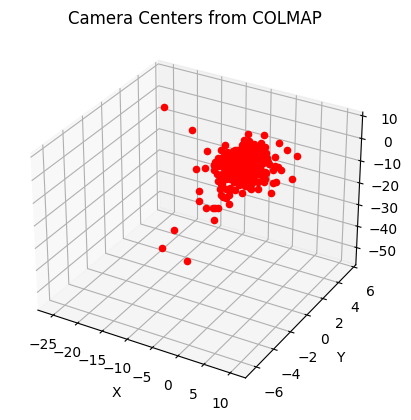

In [20]:

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for idx,_ in clusters.items():
    poses = colmap_results[idx]["pose_rt"]
    for img_name, pose in poses.items():
        c = -pose["rotation"].T @ pose["translation"]
        ax.scatter(c[0], c[1], c[2], c='r')

ax.set_title("Camera Centers from COLMAP")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.show()


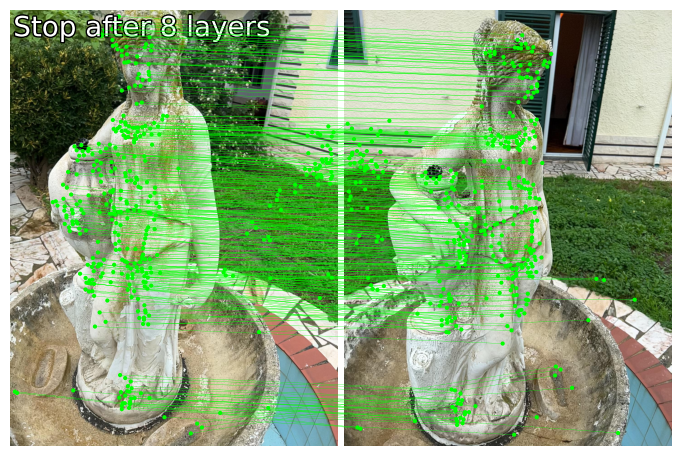

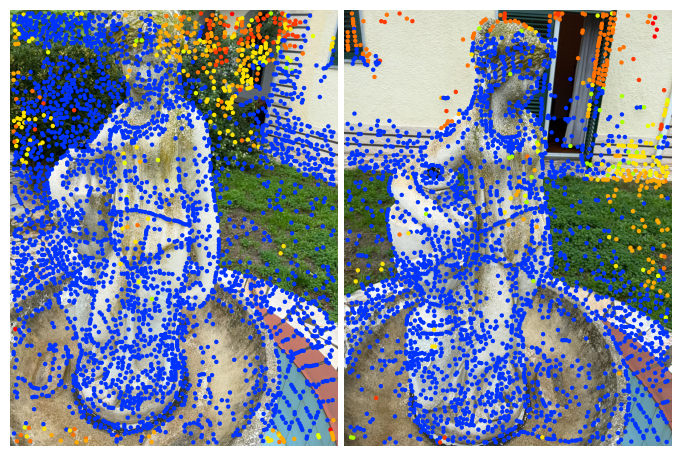

In [31]:
# from cluster 0
pose_img1 = 'imc2023_haiper/fountain_image_012.png' 
pose_img2 = 'imc2023_haiper/fountain_image_025.png'

keypoint_match_visualiser(pose_img1, pose_img2)

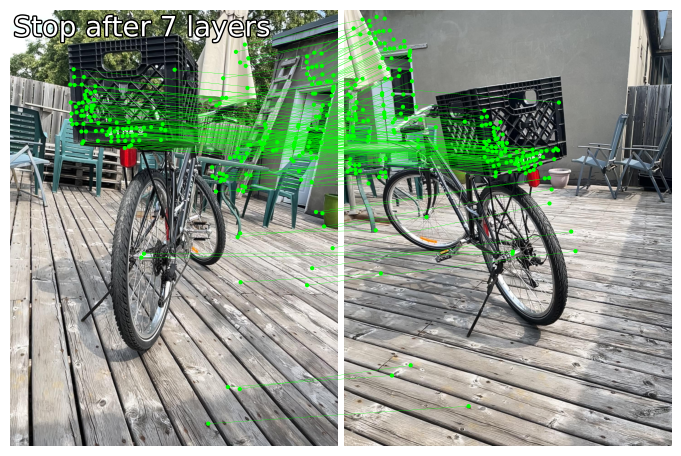

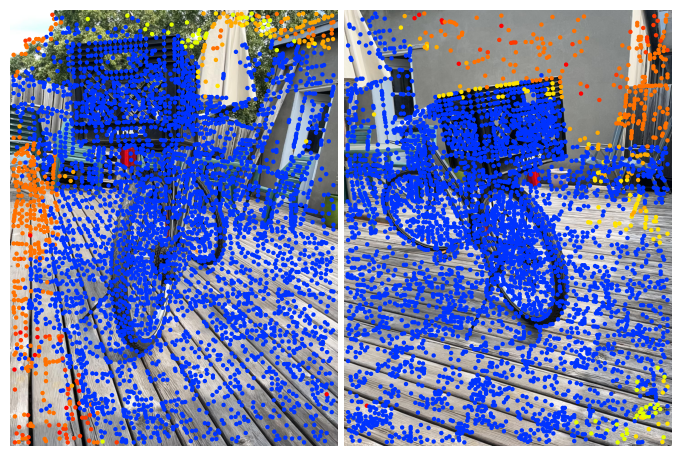

In [22]:
# cluster 1
pose1 = 'imc2023_haiper/bike_image_115.png'
pose2 = 'imc2023_haiper/bike_image_119.png'
keypoint_match_visualiser(pose1, pose2)

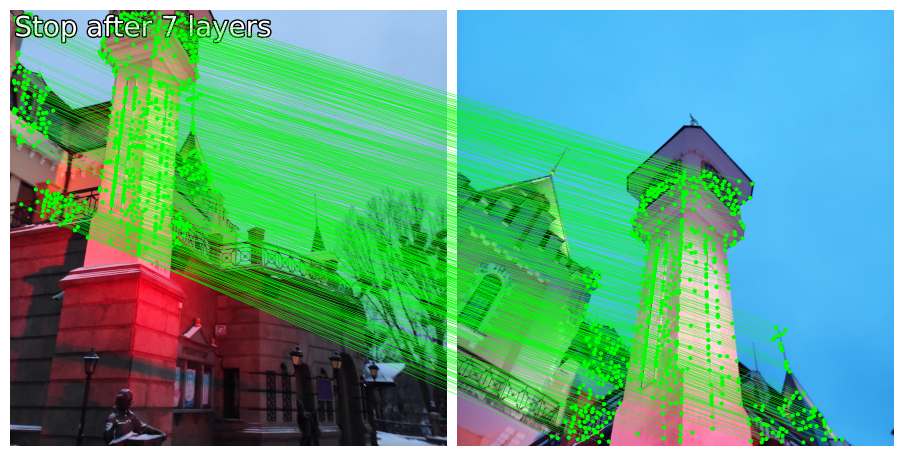

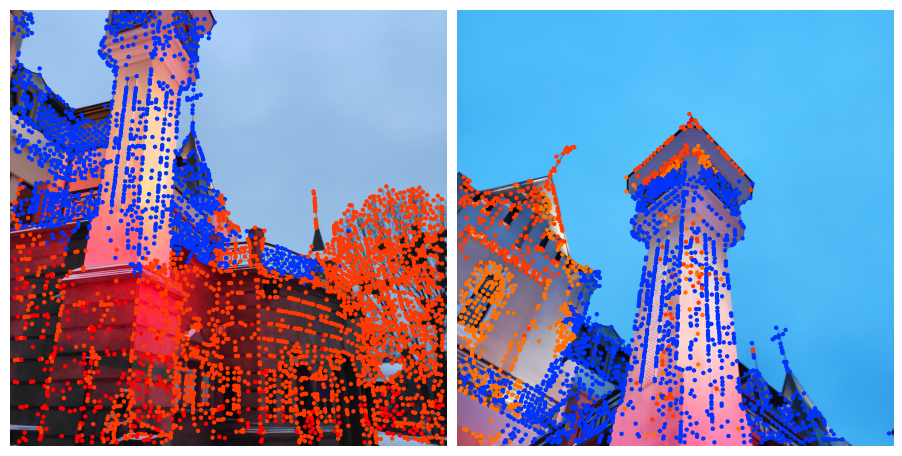

In [23]:
# cluster 5
pose_img1 = 'imc2023_theather_imc2024_church/kyiv_puppet_theater_img_20220127_165703.png'
pose_img2 = 'imc2023_theather_imc2024_church/kyiv_puppet_theater_img_20220127_165709.png'
keypoint_match_visualiser(pose_img1, pose_img2)

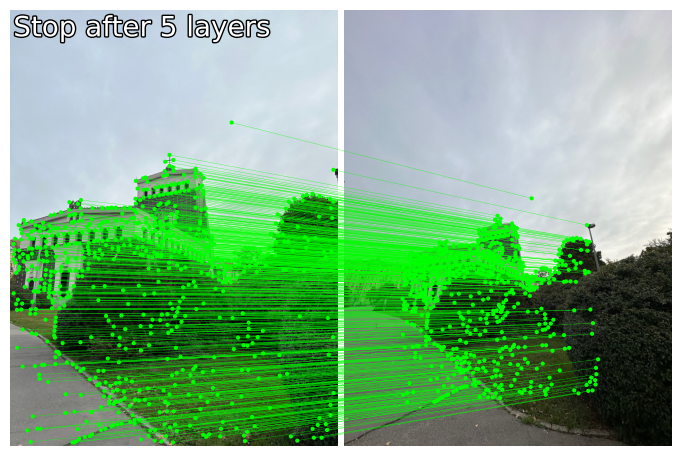

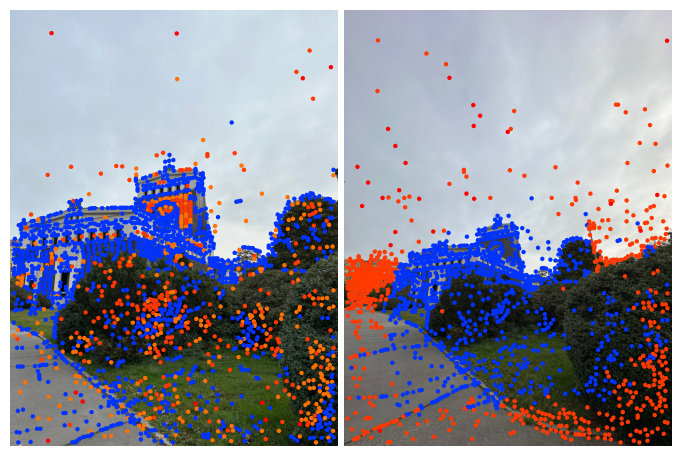

In [24]:
#cluster 5
pose_img1 = 'imc2023_theather_imc2024_church/church_00004.png'
pose_img2 = 'imc2023_theather_imc2024_church/church_00005.png'
keypoint_match_visualiser(pose_img1, pose_img2)

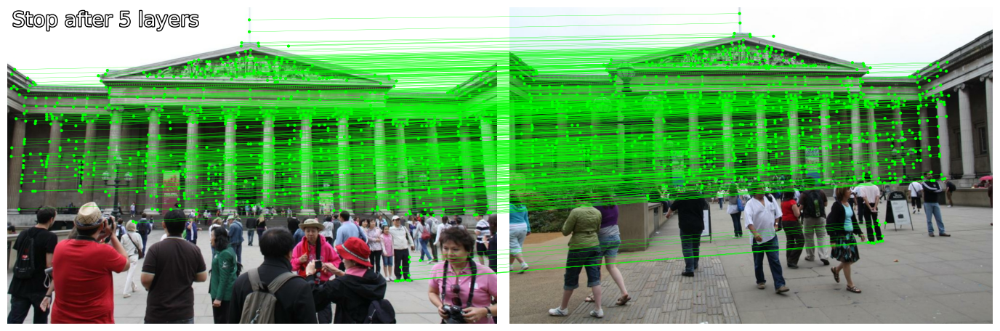

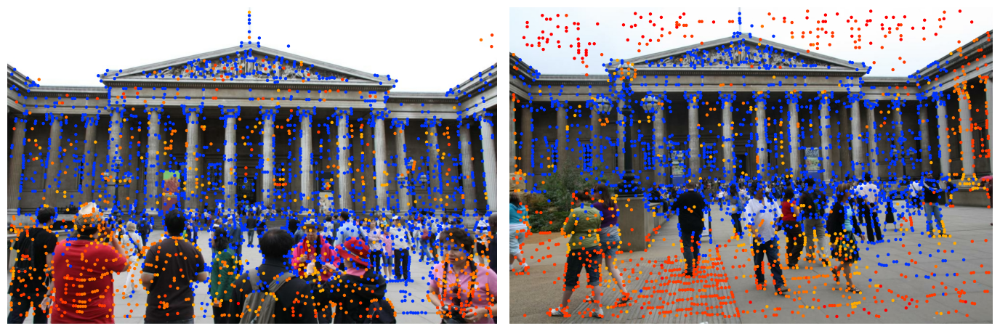

In [25]:
pose_img1 = 'pt_brandenburg_british_buckingham/british_museum_04790098_4924719784.png'
pose_img2 = 'pt_brandenburg_british_buckingham/british_museum_09218102_3818070255.png'
keypoint_match_visualiser(pose_img1, pose_img2)

## Depth Points Visualization
> * ### The depth point overlays visualize sparse 3D points, triangulated by COLMAP using geometrically verified 2D matches obtained from LightGlue + SuperPoint. These points are projected back onto the original image planes and color-coded by depth.
> * ### Closer points → cool colors (purple/blue)
> * ### Farther points → warm colors (red/yellow)

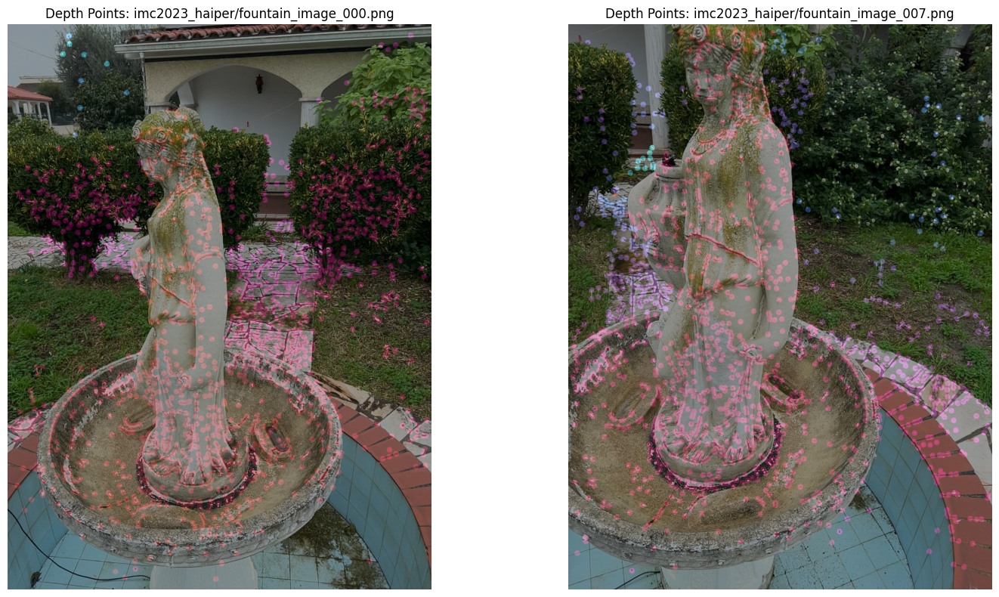

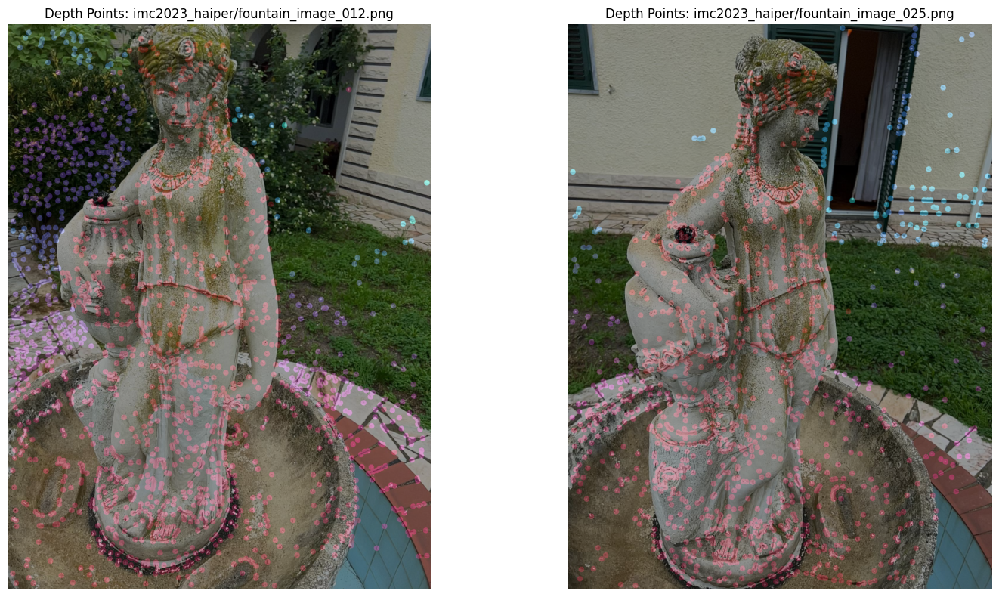

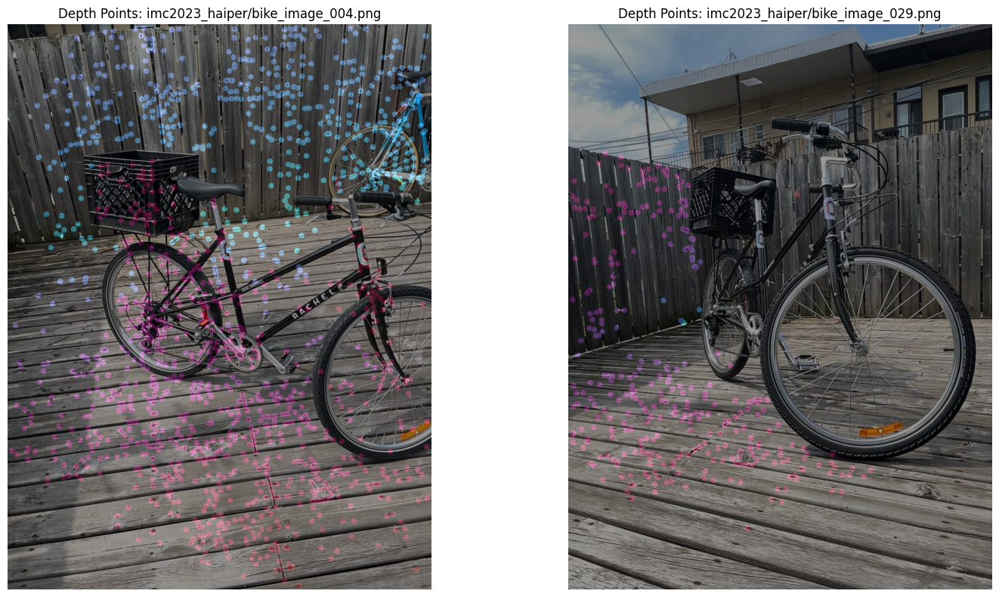

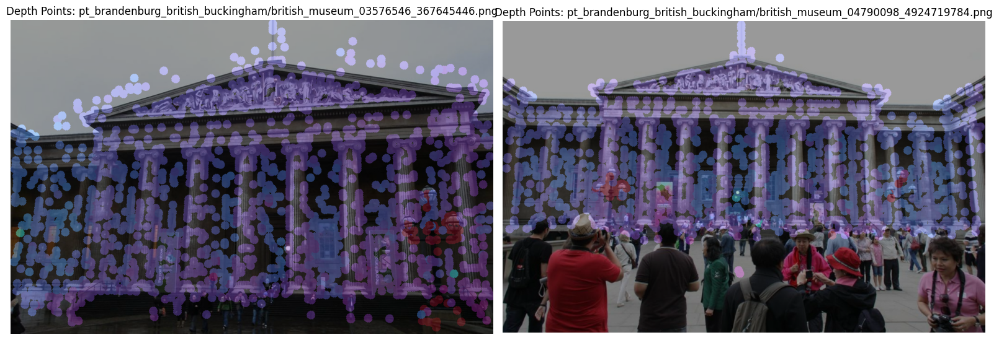

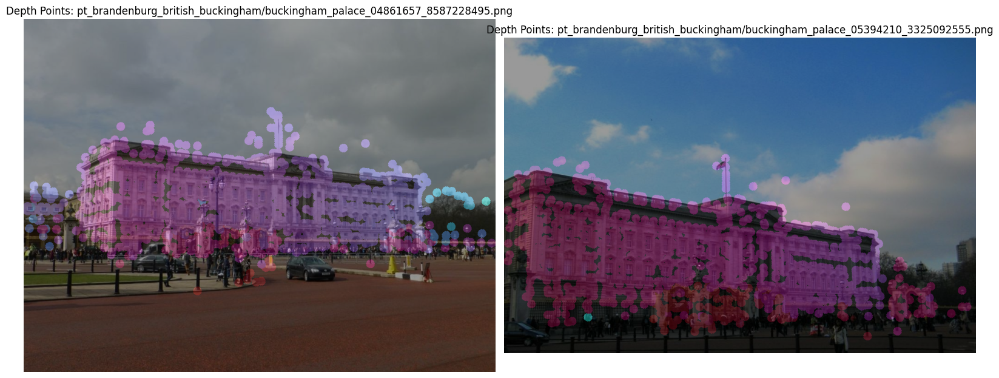

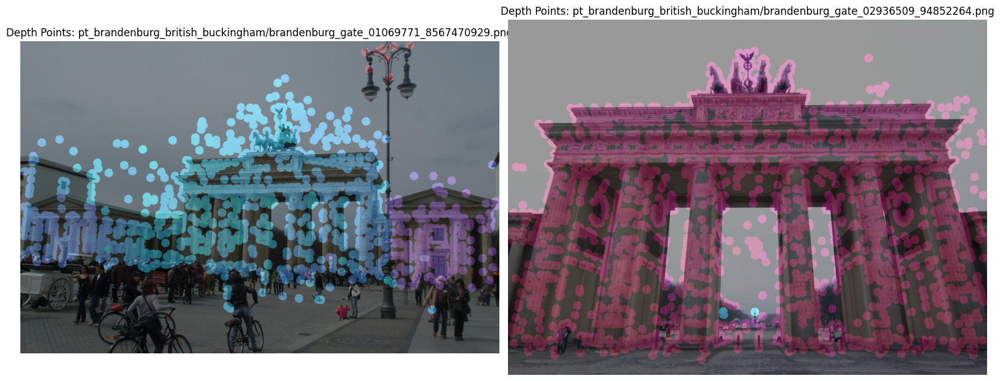

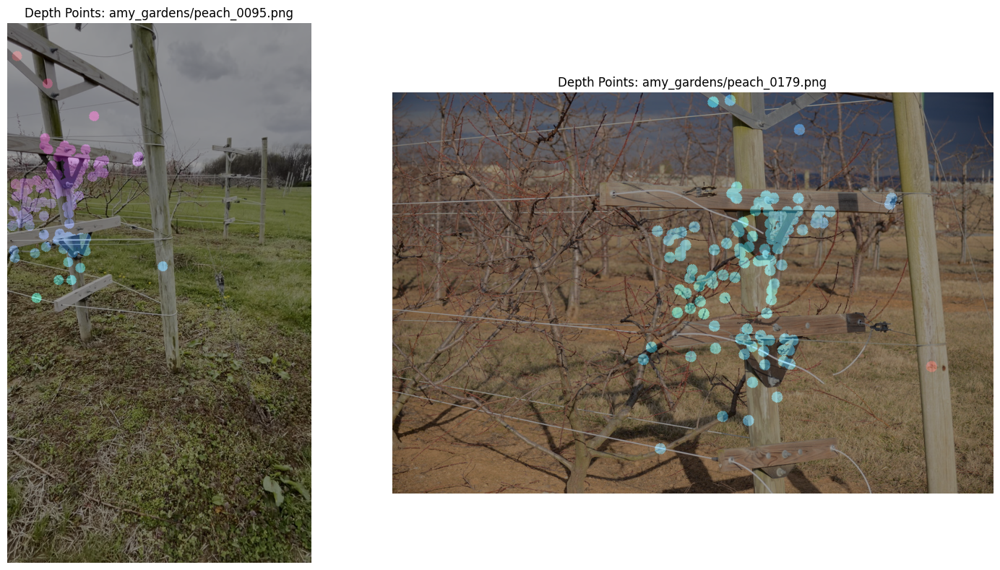

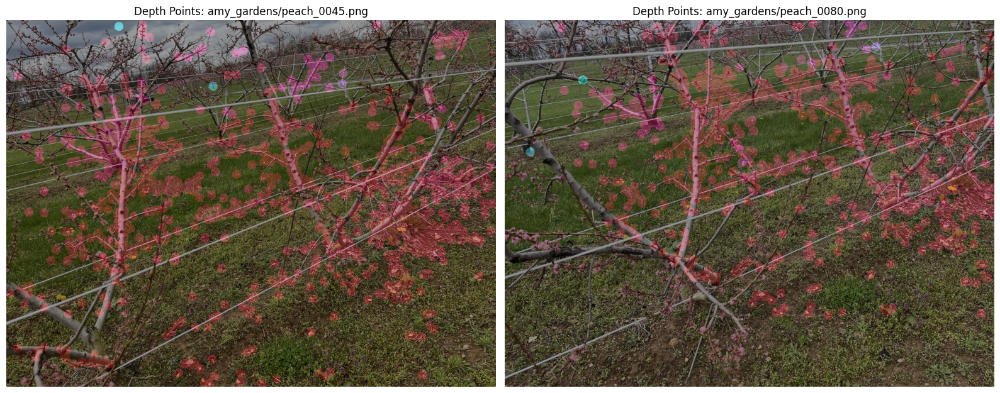

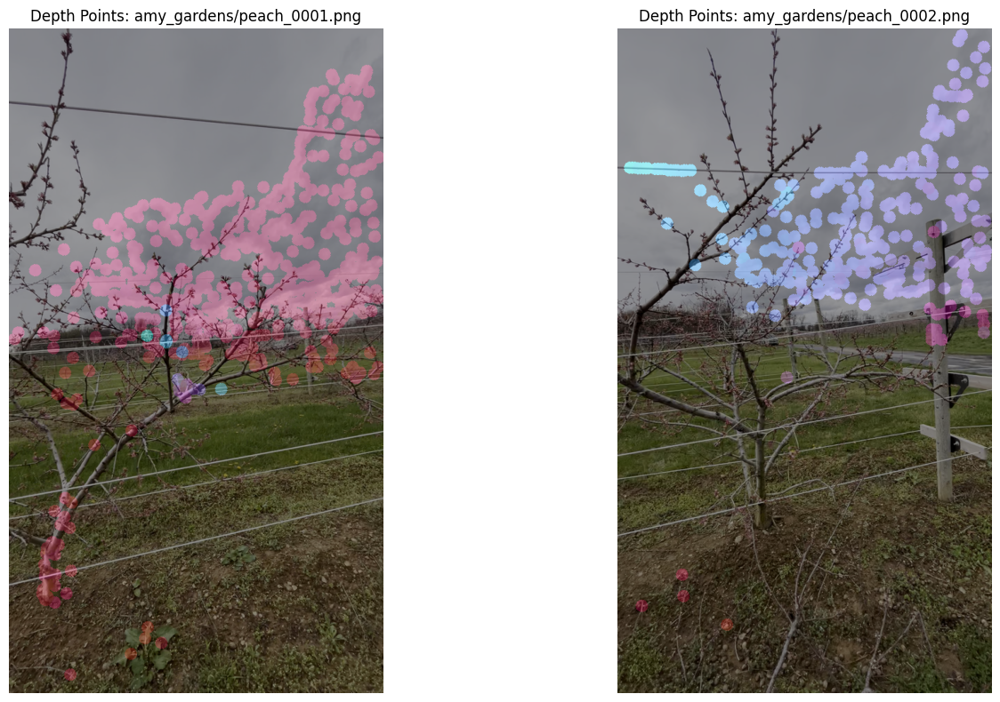

In [33]:
# STEP 4
# Depth Points visualisation

img_count = 0

for idx, _ in clusters.items():
    colmap_preds = colmap_results[idx]["colmap_res"]
    
    for i in range(0, len(colmap_preds) - 1, 2): 
        preds_pair = colmap_preds[i:i+2]
        fig, axs = plt.subplots(1, 2, figsize=(16, 8))

        for j, pred in enumerate(preds_pair):
            rgb = np.array(Image.open(pred.datapath).convert("RGB")).astype(np.float32) / 255.0
            depth_overlay = np.zeros_like(rgb)

            if pred.depth_points.size == 0:
                continue

            depths = pred.depth_points[:, 2]
            z_min, z_max = depths.min(), depths.max()

            for x, y, z in pred.depth_points:
                x, y = int(round(x)), int(round(y))
                if 0 <= y < rgb.shape[0] and 0 <= x < rgb.shape[1]:
                    norm_z = (z - z_min) / (z_max - z_min + 1e-8)
                    color = plt.cm.plasma(norm_z)[:3]
                    cv2.circle(depth_overlay, (x, y), radius=3, color=color[::-1], thickness=12)

            blended = 0.6 * rgb + 0.4 * depth_overlay
            axs[j].imshow(blended)
            axs[j].set_title(f"Depth Points: {pred.filename}")
            axs[j].axis("off")

        plt.tight_layout()
        plt.show()
        
        img_count += 2
        if img_count >= 4:
            break

            


## Epipolar Geometry Insight
> ### In epipolar geometry, each matched point between two images defines a line of sight extending in 3D space. The epipolar line in one image indicates where the corresponding point should lie in the other image, assuming a consistent 3D structure and camera motion. When multiple views are available (i.e., different camera orientations), the intersection of these lines in 3D space reveals the true depth of the scene point—this is the principle behind triangulation in Structure-from-Motion (SfM). Thus, the colored points lying along corresponding epipolar lines across image pairs indicate geometrically verified matches, which COLMAP uses to build both the 3D point cloud and sparse depth maps.

Reconstruction(num_cameras=23, num_images=23, num_reg_images=23, num_points3D=9472)


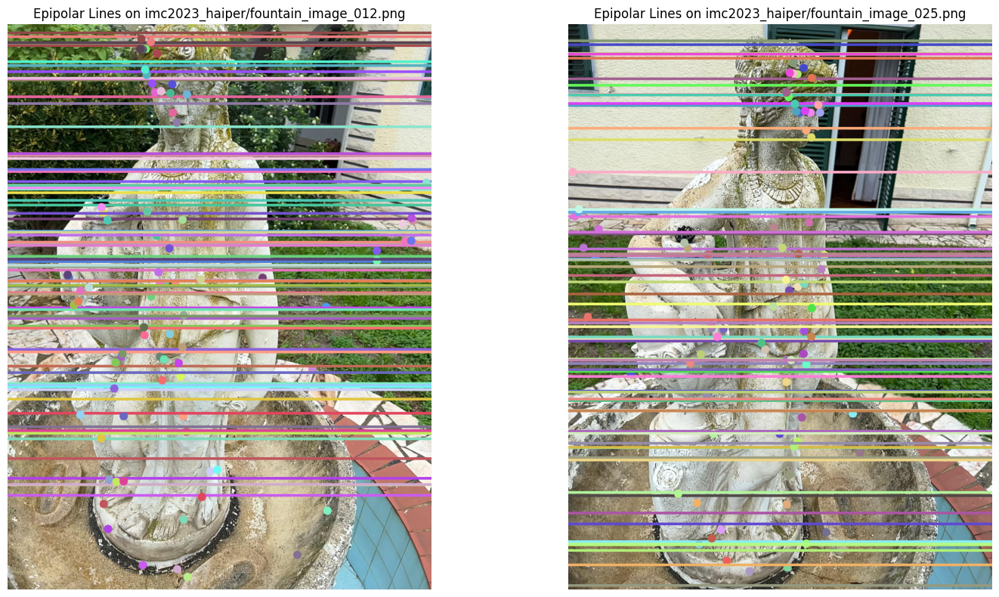

In [35]:

# epipolar on depth plot
img_nameA = 'imc2023_haiper/fountain_image_012.png' 
img_nameB = 'imc2023_haiper/fountain_image_025.png'
for idx,_ in clusters.items():
    model = colmap_results[idx]["models"]
    colmap_preds = colmap_results[idx]["colmap_res"]
    predA = predB = None
    for pred in colmap_preds:
        if pred.filename == img_nameA:
            predA = pred
            img_model = model[predA.colmap_model_id]
        if pred.filename == img_nameB:
            predB = pred
            
        if predA and predB and img_model:            
            print(img_model)
            epipolar(img_model, predA, predB, max_points=80)
            break



* ### Visualized epipolar lines across the image pair using only shared 3D points.
* ### Each color corresponds to a point match (derived from a 3D point seen in both images).
* ### The epipolar line drawn on the second image shows where that 3D point should appear, given the camera motion.
* ### The fact that the point lies on the line confirms geometric correctness.
* ### This is also a consistency check for triangulated 3D structure and camera motion.